In [1]:
from google.colab import files
uploaded=files.upload()

Saving data.xlsx to data.xlsx


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [3]:
import plotly.io as pio
pio.templates.default = "plotly_dark"

np.random.seed(31)
pd.set_option('display.max_columns', None)
sns.set_theme(context='notebook', style='darkgrid', palette='deep',
              font='sans-serif', font_scale=1, color_codes=True, rc=None)

In [4]:
main=pd.read_excel("data.xlsx")

In [ ]:
pip install pandas-profiling

In [ ]:
import pandas as pd


from pandas_profiling import ProfileReport


# Generate a profile report
profile = ProfileReport(main, title="Credit Score Dataset Profiling", explorative=True)

# Save the report to an HTML file
profile.to_file("Credit_score_report.html")


In [6]:
main.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,5634,3392,1,Aaron Maashoh,23,821000265,Scientist,19114.12,1824.843333,3,4,3,4,"auto loan,credit-builder loan,personal loan,ho...",3,7,11.27,4,Good,809.98,26.822620,265,No,49.574949,21.46538,High_spent_Small_value_payments,312.494089,Good
1,5635,3392,2,Aaron Maashoh,23,821000265,Scientist,19114.12,1824.843333,3,4,3,4,"auto loan,credit-builder loan,personal loan,ho...",3,4,11.27,4,Good,809.98,31.944960,266,No,49.574949,21.46538,Low_spent_Large_value_payments,284.629162,Good
2,5636,3392,3,Aaron Maashoh,23,821000265,Scientist,19114.12,1824.843333,3,4,3,4,"auto loan,credit-builder loan,personal loan,ho...",3,7,11.27,4,Good,809.98,28.609352,267,No,49.574949,21.46538,Low_spent_Medium_value_payments,331.209863,Good
3,5637,3392,4,Aaron Maashoh,23,821000265,Scientist,19114.12,1824.843333,3,4,3,4,"auto loan,credit-builder loan,personal loan,ho...",5,4,6.27,4,Good,809.98,31.377862,268,No,49.574949,21.46538,Low_spent_Small_value_payments,223.451310,Good
4,5638,3392,5,Aaron Maashoh,23,821000265,Scientist,19114.12,1824.843333,3,4,3,4,"auto loan,credit-builder loan,personal loan,ho...",6,4,11.27,4,Good,809.98,24.797347,269,No,49.574949,21.46538,High_spent_Medium_value_payments,341.489231,Good


In [7]:
# Function to create numerical and categorical tables
def describe_data(df):
  # Create numerical and categorical describe tables
  num_describe = df.describe()
  num_describe = num_describe.T.reset_index()
  cat_describe = df.describe(exclude=np.number)
  cat_describe = cat_describe.T.reset_index()
  # Create null and data types tables
  dtypes = df.dtypes.reset_index()
  dtypes.columns = ['index','dtype']
  null = pd.DataFrame(df.isna().sum()).reset_index()
  null.columns = ['index','null_values']
  # Merge null values and data types to describe tables
  num_describe = num_describe.merge(null, how='left', on='index')
  num_describe = num_describe.merge(dtypes, how='left', on='index')
  cat_describe = cat_describe.merge(null, how='left', on='index')
  cat_describe = cat_describe.merge(dtypes, how='left', on='index')

  return num_describe, cat_describe

In [8]:
num_describe, cat_describe = describe_data(main)

num_describe

,index,count,mean,std,min,25%,50%,75%,max,null_values,dtype
0,ID,40556.0,3.604850e+04,1.756148e+04,5634.000000,2.084075e+04,3.604750e+04,5.125825e+04,6.646500e+04,0,int64
1,Customer_ID,40556.0,2.585801e+04,1.435707e+04,1006.000000,1.375300e+04,2.543800e+04,3.842500e+04,5.099200e+04,0,int64
2,Month,40556.0,4.499803e+00,2.291316e+00,1.000000,2.000000e+00,4.000000e+00,6.000000e+00,8.000000e+00,0,int64
3,Age,40556.0,3.314442e+01,1.070945e+01,14.000000,2.400000e+01,3.300000e+01,4.100000e+01,5.600000e+01,0,int64
4,SSN,40556.0,4.974100e+08,2.911667e+08,630442.000000,2.424523e+08,4.948016e+08,7.527217e+08,9.999573e+08,0,int64
5,Annual_Income,40556.0,5.075815e+04,3.867211e+04,7005.930000,1.940340e+04,3.717129e+04,7.170322e+04,1.799873e+05,0,float64
6,Monthly_Inhand_Salary,40556.0,4.215323e+03,3.211379e+03,332.128333,1.640775e+03,3.091000e+03,5.961637e+03,1.513670e+04,0,float64
7,Num_Bank_Accounts,40556.0,5.339678e+00,2.614125e+00,0.000000,3.000000e+00,5.000000e+00,7.000000e+00,1.000000e+01,0,int64
8,Num_Credit_Card,40556.0,5.545246e+00,2.056854e+00,0.000000,4.000000e+00,5.000000e+00,7.000000e+00,1.100000e+01,0,int64
9,Interest_Rate,40556.0,1.442647e+01,8.740480e+00,1.000000,7.000000e+00,1.300000e+01,2.000000e+01,3.400000e+01,0,int64


In [9]:
cat_describe

,index,count,unique,top,freq,null_values,dtype
0,Name,40556,4629,Nate Raymondw,40,0,object
1,Occupation,40556,15,Lawyer,2880,0,object
2,Type_of_Loan,40556,2885,No Data,4576,0,object
3,Credit_Mix,40556,3,Standard,18288,0,object
4,Payment_of_Min_Amount,40556,3,Yes,21273,0,object
5,Payment_Behaviour,40556,6,Low_spent_Small_value_payments,11646,0,object
6,Credit_Score,40556,3,Standard,21409,0,object


In [10]:
fig = px.pie(main, names='Credit_Score', color='Credit_Score',hole=.3,
       color_discrete_sequence=px.colors.qualitative.Pastel,
       width=800, height=400, title="Credit Score Distribution")
fig.update_traces(textposition='inside', textinfo='percent+label', showlegend=False)

In [11]:
px.histogram(main, x='Num_Credit_Card', text_auto='d',
             width=800, height=400, title="Distribution of Credit Cards Owned per Person")

In [12]:
px.histogram(main, x='Num_Bank_Accounts', text_auto='d',
             width=800, height=400, title="Distribution of Bank Accounts Owned per Person")

In [13]:
main[main['Num_Bank_Accounts']==0].head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
48,5706,10314,1,Nadiaq,33,411510676,Lawyer,131313.4,11242.783333,0,1,8,2,"credit-builder loan,mortgage loan",0,3,9.34,2,Good,352.16,32.200509,367,NM,137.644605,86.566388,High_spent_Medium_value_payments,858.462474,Good
49,5707,10314,2,Nadiaq,34,411510676,Lawyer,131313.4,11242.783333,0,1,8,2,"credit-builder loan,mortgage loan",0,2,15.34,4,Good,352.16,31.983710,368,No,137.644605,86.566388,High_spent_Small_value_payments,547.760457,Good
50,5708,10314,3,Nadiaq,34,411510676,Lawyer,131313.4,10469.207759,0,1,8,2,"credit-builder loan,mortgage loan",0,3,9.34,4,Good,352.16,31.803134,369,NM,911.220179,86.566388,High_spent_Large_value_payments,1038.569407,Good
51,5709,10314,4,Nadiaq,34,411510676,Lawyer,131313.4,10469.207759,0,1,8,2,"credit-builder loan,mortgage loan",0,2,8.34,4,Good,352.16,42.645785,370,No,911.220179,86.566388,High_spent_Medium_value_payments,899.198772,Good
52,5710,10314,5,Nadiaq,34,411510676,Lawyer,131313.4,10469.207759,0,1,8,2,"credit-builder loan,mortgage loan",0,4,9.34,4,Good,352.16,40.902517,371,No,911.220179,86.566388,High_spent_Large_value_payments,963.254819,Good


In [14]:
px.histogram(main, x='Payment_of_Min_Amount', text_auto='d',
             width=800, height=400, title="Distribution of Loan Payment Behaviour")

In [15]:
px.histogram(main, x='Monthly_Inhand_Salary',
             width=1200, height=400, title="Monthly Income Distribution")

In [16]:

px.histogram(main, x='Outstanding_Debt',
             width=800, height=400, title='Debt Distribution')

In [17]:
px.histogram(main[main['Total_EMI_per_month'] < 600], x='Total_EMI_per_month',
             width=1200, height=400, title='Distribution of Equated Monthly Installment (EMI)')

In [18]:
temp = main.drop(columns=['ID','Customer_ID','SSN','Name']).copy()
temp['Credit_Score'] = temp['Credit_Score'].map({'Poor':0,'Standard':1,'Good':2})
px.imshow(temp.corr(numeric_only=True), text_auto='.2f',
                  width=950, height=950, zmin=-1, zmax=1, color_continuous_scale='RdBu_r')

In [19]:
# Drop unecessary columns
main.drop(columns=['ID','SSN','Name'], inplace=True)
# Replace '0' with '1' for Number of credit card values
main['Num_Credit_Card'].replace(0,1,inplace=True)
# Replace Minimum Payment value 'NM' with 'No'
main['Payment_of_Min_Amount'].replace('NM','No',inplace=True)
# Remap Month values
import calendar
main['Month'] = main['Month'].apply(lambda x: calendar.month_abbr[x])

In [20]:
# Make copy for detailed analysis
df = main.copy()
# Make target feature as Categorical for easy ordered sorting
df['Credit_Score'] = pd.Categorical(df['Credit_Score'], ordered=True, categories=['Poor', 'Standard', 'Good'])
df.sort_values('Credit_Score', inplace=True)

In [21]:
px.histogram(df, x='Age', color='Credit_Score', facet_row='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=400, title='Age Distribution by Credit Score')

In [22]:
# Create Age Group column
def assign_age_group(row):
  if row['Age'] <= 17:
    return '0_Teen'
  elif row['Age'] <= 30:
    return '1_Young Adult'
  elif row['Age'] <= 45:
    return '2_Middled-aged'
  else:
    return '3_Old-aged'

df['Age_Group'] = df.apply(assign_age_group, axis=1)

In [23]:
px.histogram(df.sort_values('Age_Group'), y='Age_Group', color='Credit_Score', barnorm='percent', text_auto='.2f',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=800, height=400, title='Credit Score Proportion by Age Groups')

In [24]:
fig = px.box(df.sort_values('Age_Group'), x='Monthly_Inhand_Salary', y='Age_Group', color='Age_Group',
             color_discrete_sequence=px.colors.sequential.Burgyl,
             width=1000, height=500, title='Income Distribution by Age Group')
fig.update_layout(showlegend=False)


In [25]:
px.histogram(df, x='Monthly_Inhand_Salary', color='Credit_Score', facet_row='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=400, title='Monthly Salary Distribution by Credit Score')

In [26]:
fig = px.box(df, x='Monthly_Inhand_Salary', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Monthly Salary Distribution by Credit Score')
fig.update_layout(showlegend=False)

<ipython-input-27-007e97e7c0e0>:13: UserWarning:

FixedFormatter should only be used together with FixedLocator



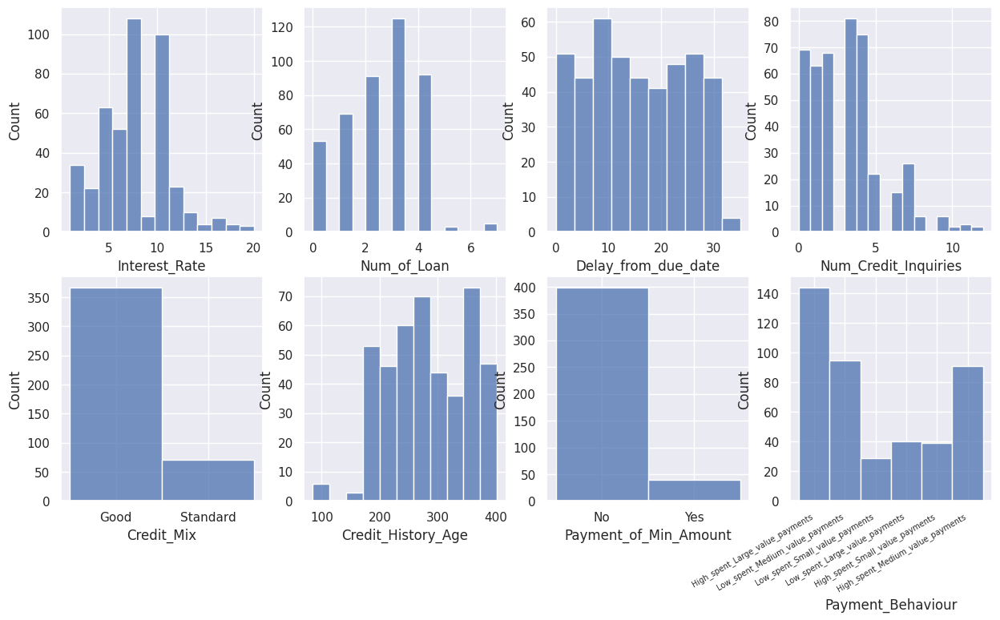

In [27]:
# Get data for Poor Credit Scorer with very high income
poor_outliers = df[(df['Credit_Score']=='Poor') & (df['Monthly_Inhand_Salary']>=10000)]
# Plot distribution for quick overview of outliers
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15,8))
sns.histplot(poor_outliers['Interest_Rate'], ax=axes[0, 0])
sns.histplot(poor_outliers['Num_of_Loan'], ax=axes[0, 1])
sns.histplot(poor_outliers['Delay_from_due_date'], ax=axes[0, 2])
sns.histplot(poor_outliers['Num_Credit_Inquiries'], ax=axes[0, 3])
sns.histplot(poor_outliers['Credit_Mix'], ax=axes[1, 0])
sns.histplot(poor_outliers['Credit_History_Age'], ax=axes[1, 1])
sns.histplot(poor_outliers['Payment_of_Min_Amount'], ax=axes[1, 2])
sns.histplot(poor_outliers['Payment_Behaviour'], ax=axes[1, 3])
axes[1,3].set_xticklabels(axes[1,3].get_xticklabels(), rotation=30, fontsize=7, ha='right')
plt.show();

In [28]:
print(f"Percentage of Poor Outliers: {len(poor_outliers) / len(df) * 100}%")

Percentage of Poor Outliers: 1.0799881645132656%


In [29]:
px.histogram(df, x='Occupation', color='Credit_Score', barmode='group', histfunc='count',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=500, title='Credit Score Distribution by Occupation')

In [30]:
px.box(df, y='Monthly_Inhand_Salary', x='Occupation',
       width=1200, height=500, title='Income Distribution by Occupation')


In [31]:
fig = px.box(df, x='Total_EMI_per_month', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Monthly Loan Payment Distribution by Credit Score')
fig.update_layout(showlegend=False)

In [32]:
# Calculate the Debt to Income ratio onto a new column
df['DTI'] = df['Total_EMI_per_month'] / df['Monthly_Inhand_Salary'] * 100
# Shows only people who are paying debts
px.histogram(df[(df['DTI']!=0) & (df['DTI']<=50)], x='DTI', color='Credit_Score', facet_row='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=500, title='DTI Ratio Distribution by Credit Score', labels={'DTI':'DTI(percent)'})

In [33]:
fig = px.box(df, x='Num_Credit_Card', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Number of Cards Distribution by Credit Score')
fig.update_layout(showlegend=False)

In [34]:
fig = px.box(df, x='Num_Bank_Accounts', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Number of Accounts Distribution by Credit Score')
fig.update_layout(showlegend=False)

In [35]:
px.scatter(df, x='Num_Bank_Accounts', y='Num_Credit_Card', color='Num_Credit_Card', trendline="ols",
           width=700, height=500, title='Number of Accounts by Number of Cards')

In [36]:
px.histogram(df, x='Delay_from_due_date', color='Credit_Score', facet_row='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=400, title='Days Late from Due Distribution by Credit Score', labels={'Delay_from_due_date':'Delay_from_due_date(days)'})

In [37]:
# Create Delay Group column
def assign_delay_group(row):
  if row['Delay_from_due_date'] <= 4:
    return '0_Up to 4days'
  elif row['Delay_from_due_date'] <= 15:
    return '1_Over 4days'
  elif row['Delay_from_due_date'] <= 30:
    return '2_Over 15days'
  else:
    return '3_Over 30days'

df['Delay_Group'] = df.apply(assign_delay_group, axis=1)

In [38]:
px.histogram(df.sort_values(['Delay_Group', 'Credit_Score']), y='Delay_Group', color='Credit_Score', barnorm='percent', text_auto='.2f',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=800, height=400, title='Credit Score Proportion by Days Late from Due Group')

In [39]:
px.histogram(df, x='Num_of_Delayed_Payment', color='Credit_Score', facet_row='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=400, title='Late Payment Frequency Distribution by Credit Score')

In [40]:
# Create Delay Habit column
def assign_delay_freq(row):
  if row['Num_of_Delayed_Payment'] <= 7:
    return '0_Up to 7times'
  elif row['Num_of_Delayed_Payment'] <= 12:
    return '1_Over 7times'
  elif row['Num_of_Delayed_Payment'] <= 20:
    return '2_Over 12times'
  else:
    return '3_Over 20times'

df['Delay_Frequency'] = df.apply(assign_delay_freq, axis=1)

In [41]:
px.histogram(df.sort_values(['Delay_Frequency','Credit_Score']), y='Delay_Frequency', color='Credit_Score', barnorm='percent', text_auto='.2f',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=800, height=400, title='Credit Score Proportion by Late Frequency Group')

In [42]:
fig = px.box(df.sort_values('Delay_Frequency'), x='Num_of_Loan', y='Delay_Frequency', color='Delay_Frequency',
             color_discrete_sequence=px.colors.sequential.Teal,
             width=1000, height=500, title='Number of Loan Distribution by Delay Frequency Group')
fig.update_layout(showlegend=False)

In [43]:
fig = px.box(df, x='Num_of_Loan', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Loans Distribution by Credit Score')
fig.update_layout(showlegend=False)

In [44]:
fig = px.box(df.sort_values('Age_Group'), x='Num_of_Loan', y='Age_Group', color='Age_Group',
             color_discrete_sequence=px.colors.sequential.Burgyl,
             width=1000, height=500, title='Number of Loan Distribution by Age Group')
fig.update_layout(showlegend=False)

In [45]:
fig = px.box(df.sort_values('Age_Group'), x='Outstanding_Debt', y='Age_Group', color='Age_Group',
             color_discrete_sequence=px.colors.sequential.Burgyl,
             width=1000, height=500, title='Number of Loan Distribution by Age Group')
fig.update_layout(showlegend=False)


In [46]:
fig = px.box(df, x='Outstanding_Debt', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Debt Distribution by Credit Score')
fig.update_layout(showlegend=False)

<ipython-input-47-30c7c748ce1e>:13: UserWarning:

FixedFormatter should only be used together with FixedLocator



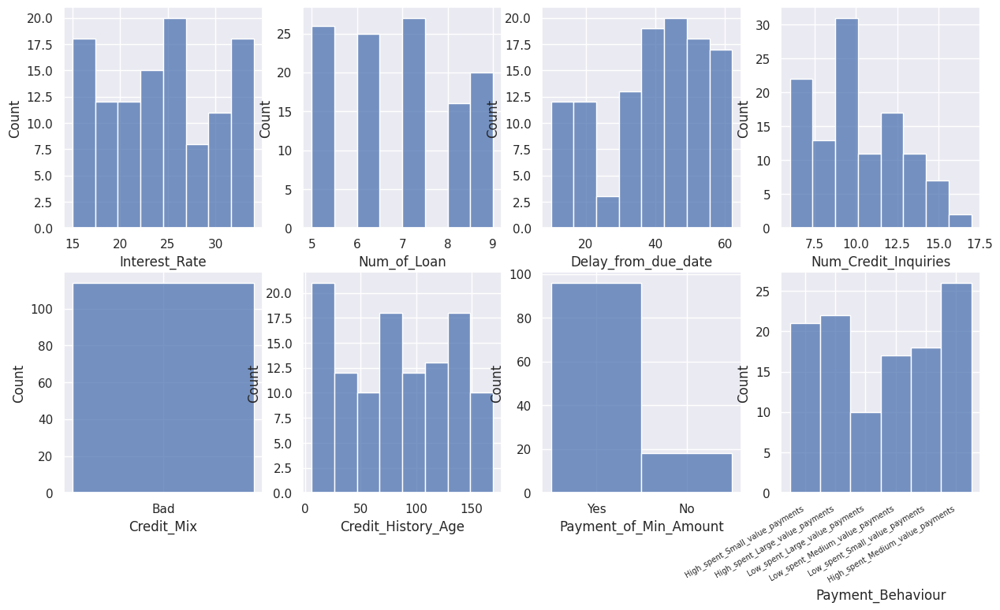

In [47]:
# Get outliers Good Scorer with very high Debt
good_outliers = df[(df['Credit_Score']=='Good') & (df['Outstanding_Debt']>=3000)]
# Plot distribution for quick overview of outliers
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15,8))
sns.histplot(good_outliers['Interest_Rate'], ax=axes[0, 0])
sns.histplot(good_outliers['Num_of_Loan'], ax=axes[0, 1])
sns.histplot(good_outliers['Delay_from_due_date'], ax=axes[0, 2])
sns.histplot(good_outliers['Num_Credit_Inquiries'], ax=axes[0, 3])
sns.histplot(good_outliers['Credit_Mix'], ax=axes[1, 0])
sns.histplot(good_outliers['Credit_History_Age'], ax=axes[1, 1])
sns.histplot(good_outliers['Payment_of_Min_Amount'], ax=axes[1, 2])
sns.histplot(good_outliers['Payment_Behaviour'], ax=axes[1, 3])
axes[1,3].set_xticklabels(axes[1,3].get_xticklabels(), rotation=30, fontsize=7, ha='right')
plt.show();

In [48]:
print(f"Percentage of Good Outliers: {len(good_outliers) / len(df) * 100}%")

Percentage of Good Outliers: 0.28109280994180885%


In [49]:
# Loan types are in one column separated by commas
df['Type_of_Loan'].unique()

array(['debt consolidation loan,credit-builder loan,auto loan',
       'not specified',
       'not specified,credit-builder loan,personal loan,debt consolidation loan,not specified,home equity loan,student loan,credit-builder loan',
       ..., 'credit-builder loan,student loan,not specified',
       'personal loan,not specified,student loan',
       'student loan,home equity loan,payday loan,student loan'],
      dtype=object)

In [50]:
# Function for dummifying data with Melt Option
def dummify_string(df, long_col, drop_col=None, separator=",", melt=False):
  dummies = df[long_col].str.get_dummies(sep=separator)
  # Drop unwanted dummified data if any
  if drop_col != None:
    dummies.drop(columns=drop_col, inplace=True)
  # Drop original column and merge dummy df with main df
  temp_df = df.drop(columns=long_col)
  merge_df = temp_df.merge(dummies, left_index=True, right_index=True)
  # Return dummified df if not melt
  if not melt:
    return merge_df
  # Define id_vars and value_vars if melt
  keep_col = temp_df.columns
  melt_col = dummies.columns
  # Melt
  melt_df = merge_df.melt(id_vars=keep_col,
                          value_vars=melt_col,
                          var_name=long_col,
                          value_name=long_col + "_True")
  return melt_df

In [51]:
# Dummify and Melt Loan Type Column
melted_ltype_df = dummify_string(df,"Type_of_Loan",'No Data', ",", True)
ltype_df = melted_ltype_df.groupby(['Type_of_Loan','Credit_Score'])['Type_of_Loan_True'].sum().reset_index()
px.histogram(ltype_df, x='Type_of_Loan', y ='Type_of_Loan_True', color='Credit_Score',
             barmode='stack', histfunc='sum',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1200, height=500, title='Credit Score Distribution by Loan Types', labels={'Type_of_Loan_True':'count'})

In [52]:
age_ltype_df = melted_ltype_df.groupby(['Age_Group','Type_of_Loan'])['Type_of_Loan_True'].sum().reset_index()
px.bar(age_ltype_df, x='Type_of_Loan', y='Type_of_Loan_True', color='Age_Group',
             barmode='group',
             color_discrete_sequence=px.colors.sequential.Burgyl,
             width=1200, height=500, title='Age Distribution by Loan Types', labels={'Type_of_Loan_True':'count'})

In [53]:

fig = px.box(df, x='Num_Credit_Inquiries', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Number of Credit Inquiries Distribution by Credit Score')
fig.update_layout(showlegend=False)

In [54]:
fig = px.violin(df, x='Credit_Utilization_Ratio', y='Credit_Score', color='Credit_Score', box=True,
                color_discrete_sequence=px.colors.qualitative.Vivid,
                width=1000, height=500, title='Credit Utilization Distribution by Credit Score', labels={'Credit_Utilization_Ratio':'Credit_Utilization_Ratio(percent)'})
fig.update_layout(showlegend=False)

In [55]:
fig = px.box(df, x='Credit_History_Age', y='Credit_Score', color='Credit_Score',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=1000, height=500, title='Credit Age Distribution by Credit Score', labels={'Credit_History_Age':'Credit_History_Age(days)'})
fig.update_layout(showlegend=False)

In [56]:
fig = px.box(df.sort_values('Age_Group'), x='Credit_History_Age', y='Age_Group', color='Age_Group',
             color_discrete_sequence=px.colors.sequential.Burgyl,
             width=1000, height=500, title='Credit Age Distribution by Age Group', labels={'Credit_History_Age':'Credit_History_Age(days)'})
fig.update_layout(showlegend=False)

In [57]:
px.histogram(df, y='Payment_of_Min_Amount', color='Credit_Score', barnorm='percent', text_auto='.2f',
             color_discrete_sequence=px.colors.qualitative.Vivid,
             width=800, height=500, title='Credit Score Proportion by Minimum Payment Behaviour')

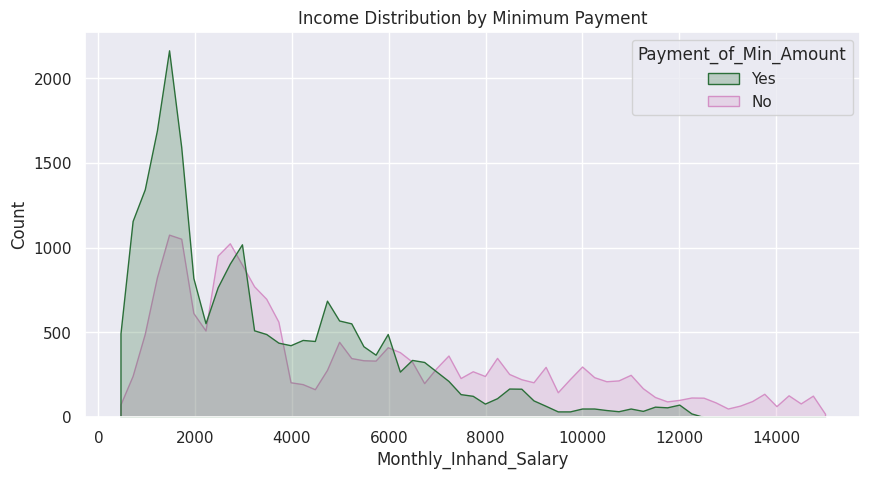

In [58]:
plt.figure(figsize=(10,5))
plt.title('Income Distribution by Minimum Payment')
sns.histplot(df, x='Monthly_Inhand_Salary', hue='Payment_of_Min_Amount', element='poly',
             palette='cubehelix');

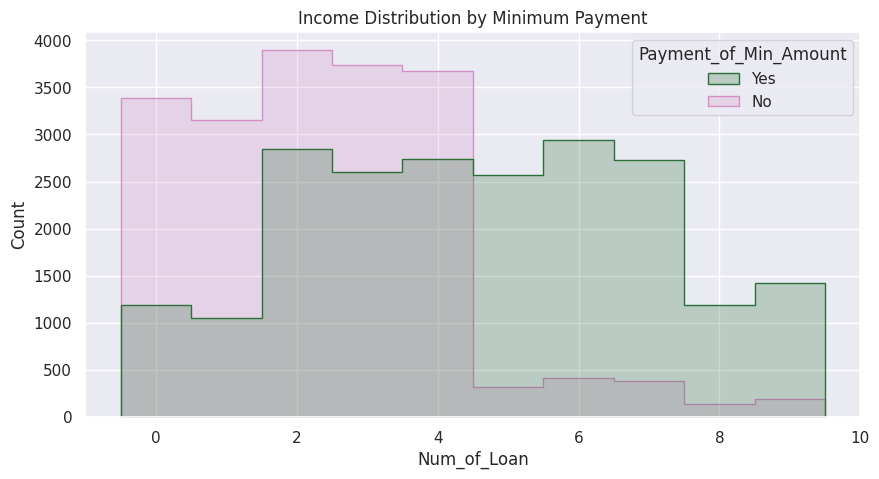

In [59]:
plt.figure(figsize=(10,5))
plt.title('Income Distribution by Minimum Payment')
sns.histplot(df, x='Num_of_Loan', hue='Payment_of_Min_Amount', element='step',
             palette='cubehelix', discrete=True);

In [60]:
fig = px.histogram(df, x='Payment_Behaviour', color='Credit_Score', barmode='stack', barnorm='percent', text_auto='.2f',
                   color_discrete_sequence=px.colors.qualitative.Vivid,
                   width=1200, height=500, title='Credit Score Proportion by Payment Behaviour')
fig.update_xaxes(categoryorder='array',categoryarray=['Low_spent_Small_value_payments', 'Low_spent_Medium_value_payments','Low_spent_Large_value_payments',
                                                      'High_spent_Small_value_payments','High_spent_Medium_value_payments','High_spent_Large_value_payments'])

In [61]:
fig = px.histogram(df, y='Credit_Mix', color='Credit_Score', barmode='stack', barnorm='percent', text_auto='.2f',
                   color_discrete_sequence=px.colors.qualitative.Vivid,
                   width=800, height=500, title='Credit Score Proportion by Credit Mix')
fig.update_yaxes(categoryorder='array',categoryarray=['Bad','Standard','Good'])

In [62]:
dummy_ltype_df = dummify_string(df,"Type_of_Loan",'No Data', ",", False)
dummy_ltype_df['Num_Loan_Types'] = dummy_ltype_df.iloc[:,-9:].sum(axis=1)
fig = px.box(dummy_ltype_df, y='Credit_Mix', x='Num_Loan_Types', color='Credit_Mix',
             color_discrete_sequence=px.colors.qualitative.G10_r,
             width=1000, height=500, title='Unique Loan Types Distribution by Credit Mix')
fig.update_layout(showlegend=False, yaxis={'categoryorder':'array', 'categoryarray':['Good','Standard','Bad']})

In [63]:
# Make copy of cleaned dataframe and drop Customer_ID and Interest Rate because it is set based on Credit Score
processing_df = main.drop(columns=['Customer_ID','Interest_Rate'])
# Dummify Type_of_Loan
processing_df = dummify_string(processing_df, long_col="Type_of_Loan", drop_col='No Data', separator=",", melt=False)
# Remap target feature
processing_df['Credit_Score'] = processing_df['Credit_Score'].map({'Poor':0,
                                                                   'Standard':1,
                                                                   'Good':2})

In [64]:
processing_df.select_dtypes(include="object").head()

,Month,Occupation,Credit_Mix,Payment_of_Min_Amount,Payment_Behaviour
0,Jan,Scientist,Good,No,High_spent_Small_value_payments
1,Feb,Scientist,Good,No,Low_spent_Large_value_payments
2,Mar,Scientist,Good,No,Low_spent_Medium_value_payments
3,Apr,Scientist,Good,No,Low_spent_Small_value_payments
4,May,Scientist,Good,No,High_spent_Medium_value_payments


In [65]:
processing_df.select_dtypes(exclude="object").head()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Credit_Score,auto loan,credit-builder loan,debt consolidation loan,home equity loan,mortgage loan,not specified,payday loan,personal loan,student loan
0,23,19114.12,1824.843333,3,4,4,3,7,11.27,4,809.98,26.822620,265,49.574949,21.46538,312.494089,2,1,1,0,1,0,0,0,1,0
1,23,19114.12,1824.843333,3,4,4,3,4,11.27,4,809.98,31.944960,266,49.574949,21.46538,284.629162,2,1,1,0,1,0,0,0,1,0
2,23,19114.12,1824.843333,3,4,4,3,7,11.27,4,809.98,28.609352,267,49.574949,21.46538,331.209863,2,1,1,0,1,0,0,0,1,0
3,23,19114.12,1824.843333,3,4,4,5,4,6.27,4,809.98,31.377862,268,49.574949,21.46538,223.451310,2,1,1,0,1,0,0,0,1,0
4,23,19114.12,1824.843333,3,4,4,6,4,11.27,4,809.98,24.797347,269,49.574949,21.46538,341.489231,2,1,1,0,1,0,0,0,1,0


In [66]:
# Split target label from features
X = processing_df.drop(columns='Credit_Score')
y = processing_df['Credit_Score']
# Split into train and test set 20%
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=31)

In [67]:
cat_features = X.select_dtypes(include="object").columns
cat_features

Index(['Month', 'Occupation', 'Credit_Mix', 'Payment_of_Min_Amount',
       'Payment_Behaviour'],
      dtype='object')

In [68]:
from sklearn.preprocessing import OneHotEncoder
# Set encoder to get binary category as only one column
encoder = OneHotEncoder(handle_unknown="ignore", drop='if_binary')
# Fit and transform
encoder.fit(X_train[cat_features])
X_cat_train_encoded = encoder.transform(X_train[cat_features])
X_cat_test_encoded = encoder.transform(X_test[cat_features])
# Convert to smallest array type
X_cat_train_encoded = X_cat_train_encoded.toarray()
X_cat_test_encoded = X_cat_test_encoded.toarray()

In [69]:
# Get encoded columns' names
encoded_cat_features = encoder.get_feature_names_out()

In [70]:
num_features = X.select_dtypes(exclude="object").columns[:16]
num_features

Index(['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Num_of_Loan', 'Delay_from_due_date',
       'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio',
       'Credit_History_Age', 'Total_EMI_per_month', 'Amount_invested_monthly',
       'Monthly_Balance'],
      dtype='object')

In [71]:
from sklearn.preprocessing import RobustScaler
rscaler = RobustScaler()
# Fit and transform
rscaler.fit(X_train[num_features])
X_num_train_scaled = rscaler.transform(X_train[num_features])
X_num_test_scaled = rscaler.transform(X_test[num_features])

In [72]:
remaining_features = X.drop(columns=num_features.append(cat_features)).columns
remaining_features

Index(['auto loan', 'credit-builder loan', 'debt consolidation loan',
       'home equity loan', 'mortgage loan', 'not specified', 'payday loan',
       'personal loan', 'student loan'],
      dtype='object')

In [73]:
# Get values of remaining columns
X_remain_train = X_train[remaining_features].values
X_remain_test = X_test[remaining_features].values
# Concatenate processed data
X_train_final = np.concatenate([X_num_train_scaled, X_cat_train_encoded, X_remain_train], axis=1)
X_test_final = np.concatenate([X_num_test_scaled, X_cat_test_encoded, X_remain_test], axis=1)

In [74]:
# Names of all columns for processed dataframe
cols_name = np.concatenate([num_features, encoded_cat_features, remaining_features], axis=0)
X_train_final = pd.DataFrame(X_train_final, columns=cols_name)
X_test_final = pd.DataFrame(X_test_final, columns=cols_name)

In [75]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import VotingClassifier

from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV, cross_val_score
from sklearn.metrics import f1_score

In [76]:
def report_scores(model, show=True):
  # Calculate accuracy score
  train_ascore = model.score(X_train_final, y_train)
  test_ascore = model.score(X_test_final, y_test)
  # Get model prediction
  y_train_pred = model.predict(X_train_final)
  y_test_pred = model.predict(X_test_final)
  # Calculate f1 score
  train_fscore = f1_score(y_train, y_train_pred, average='macro')
  test_fscore = f1_score(y_test, y_test_pred, average='macro')
  if show:
    # Print train and test accuracy score
    print(f"Train Accuracy Score: {train_ascore}")
    print(f"Test Accuracy Score: {test_ascore}\n")
    # Print train and test macro f1 score
    print(f"Train Macro F1-Score: {train_fscore}")
    print(f"Test Macro F1-Score: {test_fscore}")
  else:
    return [train_ascore, test_ascore, train_fscore, test_fscore]

In [77]:
# Calculate the error rate from cross validation on n_neighbors
error_rate = []
for i in range(1,16):
    knc = KNeighborsClassifier(n_neighbors=i, n_jobs=-1)
    score = cross_val_score(knc, X_train_final, y_train, scoring='f1_macro', cv=5)
    error_rate.append(1-score.mean())

In [78]:
elbow_df = pd.DataFrame(error_rate,
             columns=['Error_rate'])
px.line(elbow_df, y='Error_rate', x=range(1,16),
        width=800, height=400, labels={'x':'N_neighbors'})

In [79]:
# Build and fit
knc = KNeighborsClassifier(n_neighbors=5, n_jobs=-1)
knc.fit(X_train_final, y_train)

KNeighborsClassifier(n_jobs=-1)

In [80]:
report_scores(knc)

Train Accuracy Score: 0.8565220071507829
Test Accuracy Score: 0.7824211045364892

Train Macro F1-Score: 0.8503900024108527
Test Macro F1-Score: 0.770226763059204


In [81]:
# Using HalvingGridSearch to tune parameters
rfc = RandomForestClassifier(n_jobs=-1, random_state=31)
param = {'criterion':('gini','entropy'),
         'max_depth':[15,20,25]}
search = HalvingGridSearchCV(rfc, param, cv=5, scoring='f1_macro',
                             random_state=31, n_jobs=-1).fit(X_train_final, y_train)

In [82]:
cv_df = pd.DataFrame(search.cv_results_)
px.line(cv_df, y='mean_train_score', x='param_max_depth', color='param_criterion',
       width=800, height=400)

In [84]:
# Build and fit
rfc = RandomForestClassifier(criterion='entropy', max_depth=20, n_jobs=-1, random_state=31)
rfc.fit(X_train_final, y_train)

RandomForestClassifier(criterion='entropy', max_depth=20, n_jobs=-1,
                       random_state=31)

In [85]:
report_scores(rfc)

Train Accuracy Score: 0.9812600172605104
Test Accuracy Score: 0.8128698224852071

Train Macro F1-Score: 0.9802102811325538
Test Macro F1-Score: 0.8065492356356466


In [86]:
# Using HalvingGridSearch to tune parameters
gbc = GradientBoostingClassifier(random_state=31)
param = {'n_estimators':[100,150]}
search = HalvingGridSearchCV(gbc, param, cv=3, scoring='f1_macro',
                             random_state=31, n_jobs=2).fit(X_train_final, y_train)

In [89]:
# Build and fit
gbc = GradientBoostingClassifier(n_estimators=200, random_state=31)
gbc.fit(X_train_final, y_train)

GradientBoostingClassifier(n_estimators=200, random_state=31)

In [90]:
report_scores(gbc)

Train Accuracy Score: 0.7607878190112193
Test Accuracy Score: 0.7345907297830375

Train Macro F1-Score: 0.7468181484150396
Test Macro F1-Score: 0.7189756999673901


In [ ]:
# Build & fit
from sklearn.metrics import precision_score, recall_score

vcf = VotingClassifier(estimators=[('NearestNeighbors', knc), ('RandomForest', rfc), ('GradientBoosting', gbc)],
                       voting='soft', n_jobs=-1)
vcf.fit(X_train_final, y_train)
y_pred=vcf.predict(X_test_final)
precision = precision_score(y_test, y_pred,average="macro")
recall = recall_score(y_test, y_pred,average="macro")

print("Precision:", precision)
print("Recall:", recall)


In [92]:
report_scores(vcf)

Train Accuracy Score: 0.8881765503637036
Test Accuracy Score: 0.8065828402366864

Train Macro F1-Score: 0.8840015822941144
Test Macro F1-Score: 0.7993088839712237


In [93]:
train_cv = cross_val_score(vcf, X_train_final, y_train, cv=5, scoring='f1_macro')
test_cv = cross_val_score(vcf, X_test_final, y_test, cv=5, scoring='f1_macro')

In [94]:
print(f"Train Cross-Val-Scores: {list(train_cv)}")
print(f"Test Cross-Val-Scores: {list(train_cv)}\n")
print(f"Train Cross-Val-Score Standard Deviation: {np.std(train_cv)}")
print(f"Test Cross-Val-Score Standard Deviation: {np.std(test_cv)}")

Train Cross-Val-Scores: [0.7934911243222179, 0.7896289885004157, 0.7933588484051343, 0.7870617144305592, 0.7861976903417013]
Test Cross-Val-Scores: [0.7934911243222179, 0.7896289885004157, 0.7933588484051343, 0.7870617144305592, 0.7861976903417013]

Train Cross-Val-Score Standard Deviation: 0.003055645644699854
Test Cross-Val-Score Standard Deviation: 0.007307417430106201


In [96]:
models = {}
models['KNeighborsClassifer'] = report_scores(knc, show=False)
models['RandomForestClassifier'] = report_scores(rfc, show=False)
models['GradientBoostingClassifier'] = report_scores(gbc, show=False)
models['VotingClassifier'] = report_scores(vcf, show=False)

In [97]:
models_df = pd.DataFrame.from_dict(models, orient='index').reset_index()
models_df.columns = ['Model','Train_Accuracy','Test_Accuracy','Train_F1','Test_F1']
models_df.round(2).sort_values('Test_F1', ascending=False).reset_index(drop=True)

,Model,Train_Accuracy,Test_Accuracy,Train_F1,Test_F1
0,RandomForestClassifier,0.98,0.81,0.98,0.81
1,VotingClassifier,0.89,0.81,0.88,0.80
2,KNeighborsClassifer,0.86,0.78,0.85,0.77
3,GradientBoostingClassifier,0.76,0.73,0.75,0.72


In [98]:
from sklearn.metrics import confusion_matrix, classification_report
!pip install shap
import shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 5.7 MB/s eta 0:00:00


Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


In [99]:
import pandas as pd
import plotly.express as px
from sklearn.metrics import roc_auc_score, confusion_matrix, classification_report

def model_report(name, model, X, y):
    # Predict probabilities for each class using predict_proba()
    y_pred_probs = model.predict_proba(X)

    # Calculate ROC AUC score for each class (one-vs-rest strategy)
    roc_auc = roc_auc_score(y, y_pred_probs, multi_class='ovr')

    # Form confusion matrix dataframe
    y_pred = model.predict(X)
    cm_values = confusion_matrix(y, y_pred)
    df_cm = pd.DataFrame(cm_values,
                         columns=["Poor", "Standard", "Good"],
                         index=["Poor", "Standard", "Good"])

    print("ROC AUC Score:", roc_auc)
    df_cm.index.name = "Actual"
    df_cm.columns.name = "Predicted"

    # Plot confusion matrix
    fig = px.imshow(df_cm, text_auto=True, color_continuous_scale=px.colors.sequential.matter,
                    width=800, height=500, title=name)
    fig.show()

    # Print classification report
    print(classification_report(y, y_pred, target_names=['Poor', 'Standard', 'Good']))

# Assuming you have your model (knc) and data (X_test_final, y_test)
# Call the function with appropriate inputs
model_report('Nearest Neighbors Classifier', knc, X_test_final, y_test)


ROC AUC Score: 0.9056659545628852


              precision    recall  f1-score   support

        Poor       0.76      0.82      0.79      2328
    Standard       0.81      0.79      0.80      4310
        Good       0.74      0.70      0.72      1474

    accuracy                           0.78      8112
   macro avg       0.77      0.77      0.77      8112
weighted avg       0.78      0.78      0.78      8112



In [100]:
model_report('Random Forest Classifier', rfc, X_test_final, y_test)

ROC AUC Score: 0.9261803647966379


              precision    recall  f1-score   support

        Poor       0.79      0.83      0.81      2328
    Standard       0.84      0.81      0.82      4310
        Good       0.78      0.79      0.78      1474

    accuracy                           0.81      8112
   macro avg       0.80      0.81      0.81      8112
weighted avg       0.81      0.81      0.81      8112



In [101]:
model_report('Gradient Boosting Classifier', gbc, X_test_final, y_test)

ROC AUC Score: 0.8714710317862706


              precision    recall  f1-score   support

        Poor       0.73      0.70      0.71      2328
    Standard       0.78      0.76      0.77      4310
        Good       0.63      0.72      0.68      1474

    accuracy                           0.73      8112
   macro avg       0.71      0.73      0.72      8112
weighted avg       0.74      0.73      0.74      8112



In [102]:
model_report('Voting Classifier', vcf, X_test_final, y_test)

ROC AUC Score: 0.9200202438880926


              precision    recall  f1-score   support

        Poor       0.79      0.82      0.81      2328
    Standard       0.83      0.81      0.82      4310
        Good       0.76      0.78      0.77      1474

    accuracy                           0.81      8112
   macro avg       0.80      0.80      0.80      8112
weighted avg       0.81      0.81      0.81      8112

